In [652]:
# Importing Libarires

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import altair as alt
import plotly.express as px
import scipy.stats as stats
import statsmodels.api as sm
import numpy as np
import streamlit as st
import datetime

In [583]:
# Data Loading

df = pd.read_csv('vehicles_us.csv')

### The dataframe is for the Excel document of Vehicles in the United States.

In [584]:
# Data rows

# working code

df.head()

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,is_4wd,date_posted,days_listed
0,9400,2011.0,bmw x5,good,6.0,gas,145000.0,automatic,SUV,NaN,1.0,2018-06-23,19
1,25500,NaN,ford f-150,good,6.0,gas,88705.0,automatic,pickup,white,1.0,2018-10-19,50
2,5500,2013.0,hyundai sonata,like new,4.0,gas,110000.0,automatic,sedan,red,NaN,2019-02-07,79
3,1500,2003.0,ford f-150,fair,8.0,gas,NaN,automatic,pickup,NaN,NaN,2019-03-22,9
4,14900,2017.0,chrysler 200,excellent,4.0,gas,80903.0,automatic,sedan,black,NaN,2019-04-02,28


In [585]:
# Data info

# working code
 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51525 entries, 0 to 51524
Data columns (total 13 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   price         51525 non-null  int64  
 1   model_year    47906 non-null  float64
 2   model         51525 non-null  object 
 3   condition     51525 non-null  object 
 4   cylinders     46265 non-null  float64
 5   fuel          51525 non-null  object 
 6   odometer      43633 non-null  float64
 7   transmission  51525 non-null  object 
 8   type          51525 non-null  object 
 9   paint_color   42258 non-null  object 
 10  is_4wd        25572 non-null  float64
 11  date_posted   51525 non-null  object 
 12  days_listed   51525 non-null  int64  
dtypes: float64(4), int64(2), object(7)
memory usage: 5.1+ MB


### There is a total of  51524 entries and 33 columns in this list.

In [586]:
# Data types
df.dtypes

price             int64
model_year      float64
model            object
condition        object
cylinders       float64
fuel             object
odometer        float64
transmission     object
type             object
paint_color      object
is_4wd          float64
date_posted      object
days_listed       int64
dtype: object

### Three (3) data types: int64, float64, object.

In [587]:
# Current Year

# working code

current_year = datetime.datetime.now().year

In [588]:
# Age new column

# working code

df['age'] = current_year - df['model_year']

In [589]:
# Price Range new column

# working code

def price_range(price):
    if price < 10000:
        return 'Low'
    elif price < 30000:
        return 'Medium'
    else:
        return 'High'

df['price_range'] = df['price'].apply(price_range)

In [590]:
# Mileage Group new column

# working code

def mileage_group(odometer):
    if odometer < 50000:
        return 'Low'
    elif odometer < 100000:
        return 'Medium'
    else:
        return 'High'

df['mileage_group'] = df['odometer'].apply(mileage_group)

In [591]:
# Vehicle Age Group new column

# working code

def age_group(age):
    if age < 5:
        return 'New'
    elif age < 10:
        return 'Mid-Age'
    else:
        return 'Old'

df['age_group'] = df['age'].apply(age_group)

In [592]:
# Price per Mile new column

# working code

df['price_per_mile'] = df['price'] / df['odometer']

In [593]:
# Model Popularity counts new column

# working code

model_counts = df['model'].value_counts()
df['model_popularity'] = df['model'].map(model_counts)

In [594]:
# Model Popularity Category new column

# working code

# Count the occurrences of each model
model_counts = df['model'].value_counts()

# Define the popularity categories based on percentiles
def model_popularity_category(model):
    count = model_counts[model]
    if count > model_counts.quantile(0.75):
        return 'Very Popular'
    elif count > model_counts.quantile(0.5):
        return 'Popular'
    elif count > model_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply the model_popularity_category function to create the new column
df['model_popularity_category'] = df['model'].apply(model_popularity_category)

In [595]:
# Color Popularity new column 

# working code

color_counts = df['paint_color'].value_counts()
df['color_popularity'] = df['paint_color'].map(color_counts)

In [596]:
# Color Popularity Category new column 

# workign code

# Count the occurrences of each paint color
color_counts = df['paint_color'].value_counts()

# Define the popularity categories based on percentiles
def color_popularity_category(color):
    if pd.isnull(color) or color not in color_counts:
        return 'Unknown'
    count = color_counts[color]
    if count > color_counts.quantile(0.75):
        return 'Very Popular'
    elif count > color_counts.quantile(0.5):
        return 'Popular'
    elif count > color_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply the color_popularity_category function to create the new column
df['color_popularity_category'] = df['paint_color'].apply(color_popularity_category)

In [597]:
# Engine Size Category new column

# working code

def engine_size_category(cylinders):
    if cylinders < 4.0:
        return 'Small'
    elif cylinders < 6.0:
        return 'Medium'
    else:
        return 'Large'

df['engine_size_category'] = df['cylinders'].apply(engine_size_category)

In [598]:
# Price Percentile new column

# working code
 
df['price_percentile'] = df['price'].rank(pct=True)

In [599]:
# Mileage Per Year new column

# working code

df['mileage_per_year'] = df['odometer'] / (current_year - df['model_year'])

In [600]:
# Price Category new column

# working code

def price_category(price):
    if price < df['price'].quantile(0.25):
        return 'Budget'
    elif price < df['price'].quantile(0.5):
        return 'Economy'
    elif price < df['price'].quantile(0.75):
        return 'Mid-range'
    else:
        return 'Premium'

df['price_category'] = df['price'].apply(price_category)

In [601]:
# Fuel Type Popularity Category new column

# working code

# Count
fuel_type_counts = df['fuel'].value_counts()

# Define
def fuel_type_popularity_category(fuel):
    if pd.isnull(fuel) or fuel not in fuel_type_counts:
        return 'Unknown'
    count = fuel_type_counts[fuel]
    if count > fuel_type_counts.quantile(0.75):
        return 'Very Popular'
    elif count > fuel_type_counts.quantile(0.5):
        return 'Popular'
    elif count > fuel_type_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply
df['fuel_type_popularity_category'] = df['fuel'].apply(fuel_type_popularity_category)

In [602]:
# Condtion Popularity Category new column

# working code

# Count
condition_counts = df['condition'].value_counts()

# Define
def condition_popularity_category(condition):
    if pd.isnull(condition) or condition not in condition_counts:
        return 'Unknown'
    count = condition_counts[condition]
    if count > condition_counts.quantile(0.75):
        return 'Very Popular'
    elif count > condition_counts.quantile(0.5):
        return 'Popular'
    elif count > condition_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply
df['condition_popularity_category'] = df['condition'].apply(condition_popularity_category)

In [603]:
# Engine Size Popularity Category new column

# working code

# Count
engine_size_counts = df['cylinders'].value_counts()

# Define
def engine_size_popularity_category(cylinders):
    if pd.isnull(cylinders) or cylinders not in engine_size_counts:
        return 'Unknown'
    count = engine_size_counts[cylinders]
    if count > engine_size_counts.quantile(0.75):
        return 'Very Popular'
    elif count > engine_size_counts.quantile(0.5):
        return 'Popular'
    elif count > engine_size_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply
df['engine_size_popularity_category'] = df['cylinders'].apply(engine_size_popularity_category)

In [604]:
# Type Popularity Category new column

# working code

# Count
type_counts = df['type'].value_counts()

# Define
def type_popularity_category(vehicle_type):
    if pd.isnull(vehicle_type) or vehicle_type not in type_counts:
        return 'Unknown'
    count = type_counts[vehicle_type]
    if count > type_counts.quantile(0.75):
        return 'Very Popular'
    elif count > type_counts.quantile(0.5):
        return 'Popular'
    elif count > type_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply
df['type_popularity_category'] = df['type'].apply(type_popularity_category)

In [605]:
# Model Year Popularity Category

# working code

# Count
model_year_counts = df['model_year'].value_counts()

# Define
def model_year_popularity_category(model_year):
   if pd.isnull(model_year) or model_year not in model_year_counts:
       return 'Unknown'
   count = model_year_counts[model_year]
   if count > model_year_counts.quantile(0.75):
       return 'Very Popular'
   elif count > model_year_counts.quantile(0.5):
       return 'Popular'
   elif count > model_year_counts.quantile(0.25):
       return 'Moderately Popular'
   else:
       return 'Less Popular'

# Apply
df['model_year_popularity'] = df['model_year'].apply(model_year_popularity_category)

In [606]:
# Model Popularity Category new column

# working code

# Count
model_counts = df['model'].value_counts()

# Define
def model_popularity_category(model):
    if pd.isnull(model) or model not in model_counts:
        return 'Unknown'
    count = model_counts[model]
    if count > model_counts.quantile(0.75):
        return 'Very Popular'
    elif count > model_counts.quantile(0.5):
        return 'Popular'
    elif count > model_counts.quantile(0.25):
        return 'Moderately Popular'
    else:
        return 'Less Popular'

# Apply
df['model_popularity'] = df['model'].apply(model_popularity_category)

In [607]:
# Data columns

# working code

df.columns

Index(['price', 'model_year', 'model', 'condition', 'cylinders', 'fuel',
       'odometer', 'transmission', 'type', 'paint_color', 'is_4wd',
       'date_posted', 'days_listed', 'age', 'price_range', 'mileage_group',
       'age_group', 'price_per_mile', 'model_popularity',
       'model_popularity_category', 'color_popularity',
       'color_popularity_category', 'engine_size_category', 'price_percentile',
       'mileage_per_year', 'price_category', 'fuel_type_popularity_category',
       'condition_popularity_category', 'engine_size_popularity_category',
       'type_popularity_category', 'model_year_popularity'],
      dtype='object')

In [608]:
# Show rows

# working code

df.head()

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,...,color_popularity_category,engine_size_category,price_percentile,mileage_per_year,price_category,fuel_type_popularity_category,condition_popularity_category,engine_size_popularity_category,type_popularity_category,model_year_popularity
0,9400,2011.0,bmw x5,good,6.0,gas,145000.0,automatic,SUV,NaN,...,Unknown,Large,0.505696,11153.846154,Mid-range,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
1,25500,NaN,ford f-150,good,6.0,gas,88705.0,automatic,pickup,white,...,Very Popular,Large,0.901407,NaN,Premium,Very Popular,Very Popular,Very Popular,Popular,Unknown
2,5500,2013.0,hyundai sonata,like new,4.0,gas,110000.0,automatic,sedan,red,...,Popular,Medium,0.277419,10000.000000,Economy,Very Popular,Popular,Popular,Very Popular,Very Popular
3,1500,2003.0,ford f-150,fair,8.0,gas,NaN,automatic,pickup,NaN,...,Unknown,Large,0.038797,NaN,Budget,Very Popular,Moderately Popular,Very Popular,Popular,Very Popular
4,14900,2017.0,chrysler 200,excellent,4.0,gas,80903.0,automatic,sedan,black,...,Very Popular,Medium,0.696468,11557.571429,Mid-range,Very Popular,Very Popular,Popular,Very Popular,Very Popular


In [609]:
# Checking null values

# working code

df.isnull().sum()

price                                  0
model_year                          3619
model                                  0
condition                              0
cylinders                           5260
fuel                                   0
odometer                            7892
transmission                           0
type                                   0
paint_color                         9267
is_4wd                             25953
date_posted                            0
days_listed                            0
age                                 3619
price_range                            0
mileage_group                          0
age_group                              0
price_per_mile                      7892
model_popularity                       0
model_popularity_category              0
color_popularity                    9267
color_popularity_category              0
engine_size_category                   0
price_percentile                       0
mileage_per_year

### We checked the columns with null values in the US Vehicles data frame.

In [610]:
# Data statistics

# working code

df.describe()

,price,model_year,cylinders,odometer,is_4wd,days_listed,age,price_per_mile,color_popularity,price_percentile,mileage_per_year
count,51525.000000,47906.000000,46265.000000,43633.000000,25572.0,51525.00000,47906.000000,4.363300e+04,42258.000000,51525.000000,40563.000000
mean,12132.464920,2009.750470,6.125235,115553.461738,1.0,39.55476,14.249530,inf,6355.724833,0.500010,8240.672178
std,10040.803015,6.282065,1.660360,65094.611341,0.0,28.20427,6.282065,NaN,2709.326252,0.288673,4040.387630
min,1.000000,1908.000000,3.000000,0.000000,1.0,0.00000,5.000000,3.333333e-06,102.000000,0.007754,0.000000
25%,5000.000000,2006.000000,4.000000,70000.000000,1.0,19.00000,10.000000,3.603604e-02,4475.000000,0.252965,5802.721968
50%,9000.000000,2011.000000,6.000000,113000.000000,1.0,33.00000,13.000000,8.354227e-02,6244.000000,0.500427,8125.000000
75%,16839.000000,2014.000000,8.000000,155000.000000,1.0,53.00000,18.000000,2.179454e-01,7692.000000,0.750005,10473.615385
max,375000.000000,2019.000000,12.000000,990000.000000,1.0,271.00000,116.000000,inf,10029.000000,1.000000,98000.000000


### We described the dataframe above.

In [611]:
# Data Cleaning

# Dropping duplicates

# working code

df.dropna()

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,...,color_popularity_category,engine_size_category,price_percentile,mileage_per_year,price_category,fuel_type_popularity_category,condition_popularity_category,engine_size_popularity_category,type_popularity_category,model_year_popularity
5,14990,2014.0,chrysler 300,excellent,6.0,gas,57954.0,automatic,sedan,black,...,Very Popular,Large,0.701815,5795.400000,Mid-range,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
7,15990,2013.0,honda pilot,excellent,6.0,gas,109473.0,automatic,SUV,black,...,Very Popular,Large,0.730859,9952.090909,Mid-range,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
10,19500,2011.0,chevrolet silverado 1500,excellent,8.0,gas,128413.0,automatic,pickup,black,...,Very Popular,Large,0.811577,9877.923077,Premium,Very Popular,Very Popular,Very Popular,Popular,Very Popular
14,12990,2009.0,gmc yukon,excellent,8.0,gas,132285.0,automatic,SUV,black,...,Very Popular,Large,0.639243,8819.000000,Mid-range,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
16,14990,2010.0,ram 1500,excellent,8.0,gas,130725.0,automatic,pickup,red,...,Popular,Large,0.701815,9337.500000,Mid-range,Very Popular,Very Popular,Very Popular,Popular,Very Popular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51494,7999,2009.0,chevrolet equinox,excellent,6.0,gas,95021.0,automatic,SUV,silver,...,Very Popular,Large,0.444231,6334.733333,Economy,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
51500,6995,2012.0,buick enclave,excellent,6.0,gas,157000.0,automatic,SUV,white,...,Very Popular,Large,0.379059,13083.333333,Economy,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
51509,5980,2010.0,subaru impreza,excellent,4.0,gas,121778.0,manual,hatchback,white,...,Very Popular,Medium,0.303833,8698.428571,Economy,Very Popular,Very Popular,Popular,Moderately Popular,Very Popular
51513,17999,2014.0,ram 1500,like new,8.0,gas,154000.0,automatic,pickup,white,...,Very Popular,Large,0.785551,15400.000000,Premium,Very Popular,Popular,Very Popular,Popular,Very Popular


### We dropped the duplicate rows from the dataframe.

In [612]:
# Data Cleaning

# Filling Missing Values

# working code

df.fillna(0)

,price,model_year,model,condition,cylinders,fuel,odometer,transmission,type,paint_color,...,color_popularity_category,engine_size_category,price_percentile,mileage_per_year,price_category,fuel_type_popularity_category,condition_popularity_category,engine_size_popularity_category,type_popularity_category,model_year_popularity
0,9400,2011.0,bmw x5,good,6.0,gas,145000.0,automatic,SUV,0,...,Unknown,Large,0.505696,11153.846154,Mid-range,Very Popular,Very Popular,Very Popular,Very Popular,Very Popular
1,25500,0.0,ford f-150,good,6.0,gas,88705.0,automatic,pickup,white,...,Very Popular,Large,0.901407,0.000000,Premium,Very Popular,Very Popular,Very Popular,Popular,Unknown
2,5500,2013.0,hyundai sonata,like new,4.0,gas,110000.0,automatic,sedan,red,...,Popular,Medium,0.277419,10000.000000,Economy,Very Popular,Popular,Popular,Very Popular,Very Popular
3,1500,2003.0,ford f-150,fair,8.0,gas,0.0,automatic,pickup,0,...,Unknown,Large,0.038797,0.000000,Budget,Very Popular,Moderately Popular,Very Popular,Popular,Very Popular
4,14900,2017.0,chrysler 200,excellent,4.0,gas,80903.0,automatic,sedan,black,...,Very Popular,Medium,0.696468,11557.571429,Mid-range,Very Popular,Very Popular,Popular,Very Popular,Very Popular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51520,9249,2013.0,nissan maxima,like new,6.0,gas,88136.0,automatic,sedan,black,...,Very Popular,Large,0.503503,8012.363636,Mid-range,Very Popular,Popular,Very Popular,Very Popular,Very Popular
51521,2700,2002.0,honda civic,salvage,4.0,gas,181500.0,automatic,sedan,white,...,Very Popular,Medium,0.083008,8250.000000,Budget,Very Popular,Less Popular,Popular,Very Popular,Very Popular
51522,3950,2009.0,hyundai sonata,excellent,4.0,gas,128000.0,automatic,sedan,blue,...,Popular,Medium,0.159680,8533.333333,Budget,Very Popular,Very Popular,Popular,Very Popular,Very Popular
51523,7455,2013.0,toyota corolla,good,4.0,gas,139573.0,automatic,sedan,black,...,Very Popular,Medium,0.400252,12688.454545,Economy,Very Popular,Very Popular,Popular,Very Popular,Very Popular


### We filled the missing values with '0' for better data visualization.

In [613]:
# Data Cleaning

# Converting Data Types

# working code

df['price'] = df['price'].astype('float')

### We Converted the data types to floating numbers for better data visualization.

In [614]:
# Useful Calculations

# Average Price of Vehicles

# working code

average_price = df['price'].mean()
print(f"Average price of vehicles: ${average_price:.2f}")

Average price of vehicles: $12132.46


In [615]:
# Useful Calculations

# Median Mileage of Vehicles

# working code

median_mileage = df['odometer'].median()
print(f"Median mileage of vehicles: {median_mileage:.2f} miles")

Median mileage of vehicles: 113000.00 miles


In [616]:
# Useful Calculations

# Maxium and Minimum Price of the Vehicles

# working code

max_price = df['price'].max()
min_price = df['price'].min()
print(f"Maximum price of vehicles: ${max_price:.2f}")
print(f"Minimum price of vehicles: ${min_price:.2f}")

Maximum price of vehicles: $375000.00
Minimum price of vehicles: $1.00


In [617]:
# Useful Calculations

# Average Age of the Vehicles

# working code

average_age = df['age'].mean()
print(f"Average age of vehicles: {average_age:.2f} years")

Average age of vehicles: 14.25 years


In [618]:
# Useful Calculations

# Average Price by Model Popularity Category

# working code

average_price_by_popularity = df.groupby('model_popularity_category')['price'].mean()
print("Average price by model popularity category:")
print(average_price_by_popularity)

Average price by model popularity category:
model_popularity_category
Less Popular          11297.088731
Moderately Popular    12897.559045
Popular               11730.145113
Very Popular          12280.419408
Name: price, dtype: float64


### The average price of the very popular vehicle is $12280.41.

In [619]:
# Useful Calculations

# Count of Vehicles by Fuel Type

# working code

count_by_fuel_type = df['fuel'].value_counts()
print("Count of vehicles by fuel type:")
print(count_by_fuel_type)

Count of vehicles by fuel type:
fuel
gas         47288
diesel       3714
hybrid        409
other         108
electric        6
Name: count, dtype: int64


### The amount of vehicles that run on gas is significantly higher than than those who run on diesel.

In [620]:
# Useful Calculations

# Average Mileage by Vehicle Type

# working code

average_mileage_by_type = df.groupby('type')['odometer'].mean()
print("Average mileage by vehicle type:")
print(average_mileage_by_type)

Average mileage by vehicle type:
type
SUV            118312.160118
bus            114198.173913
convertible     84189.535620
coupe           78367.868059
hatchback      111066.444934
mini-van       127968.242211
offroad        121516.791444
other          107939.748879
pickup         120877.717388
sedan          107853.607920
truck          123228.543644
van            124701.476768
wagon          123748.181331
Name: odometer, dtype: float64


### SUV vehicles have the highest average mileage.

In [621]:
# Useful Calculations

# Percentage of Vehicles by Condition

# working code

percentage_by_condition = df['condition'].value_counts(normalize=True) * 100
print("Percentage of vehicles by condition:")
print(percentage_by_condition)

Percentage of vehicles by condition:
condition
excellent    48.079573
good         39.097525
like new      9.203299
fair          3.118874
new           0.277535
salvage       0.223193
Name: proportion, dtype: float64


### Vehicles in excellent condition represent 48.07% of the total number of vehicles.

In [622]:
# Useful Calculations

# Correlation between Price and Mileage of the Vehicles

# working code

correlation = df['price'].corr(df['odometer'])
print(f"Correlation between price and mileage: {correlation:.2f}")

Correlation between price and mileage: -0.42


### Negative relationship: When one variable rises, the other tends to fall, according to the correlation coefficient's negative sign. In this instance, a vehicle's price tends to decrease as its mileage increases and vice versa.
### Moderate strength: The correlation coefficient's absolute value of 0.42 is in the range of 0.3 to 0.7, which is commonly regarded as a moderate correlation. This indicates that although the price-mileage linear relationship is not particularly strong, it is nevertheless notable and important.
### Analysis: Price and mileage have a negative association, with cars with more mileage often costing less. This relationship is not ideal, as factors like make, model, age, condition, features, and market demand also affect a car's price. The correlation coefficient measures the linear connection between the two variables, not considering non-linear relationships.



In [623]:
# Useful Calculations

# Top 5 Vehicle Models

# working code

top_5_models = df['model'].value_counts().head(5)
print("Top 5 most frequent models:")
print(top_5_models)

Top 5 most frequent models:
model
ford f-150                  2796
chevrolet silverado 1500    2171
ram 1500                    1750
chevrolet silverado         1271
jeep wrangler               1119
Name: count, dtype: int64


### The most popular vehicle model is Ford F-150 with a total of 2796 vehicle.

In [624]:
# Useful Calculations

# Top 5 Vehicle Types

# working code

type_counts = df['type'].value_counts().head(5)

print("Top 5 Vehicle Types:")
print(top_5_types)

Top 5 Vehicle Types:
type
SUV            9481
truck          9413
sedan          9193
pickup         5293
coupe          1780
wagon          1166
mini-van        887
hatchback       794
van             445
convertible     348
other           197
offroad         169
bus              19
Name: count, dtype: int64


### The most popular vehicle type are SUVs with a number of 9,481.

In [625]:
# Useful Calculations

# Price Distribution by year

# working code

price_by_year = df.groupby('model_year')['price'].agg(['mean', 'median', 'min', 'max'])
print("Price distribution by year:")
print(price_by_year)

Price distribution by year:
                    mean   median      min       max
model_year                                          
1908.0      12995.000000  12995.0  12995.0   12995.0
1929.0      18000.000000  18000.0  18000.0   18000.0
1936.0       5000.000000   5000.0   5000.0    5000.0
1948.0      21000.000000  21000.0  21000.0   21000.0
1949.0      44900.000000  44900.0  44900.0   44900.0
...                  ...      ...      ...       ...
2015.0      18399.968101  17700.0      1.0  300000.0
2016.0      19571.258632  18000.0      1.0   76000.0
2017.0      20737.426209  19700.0      1.0   68000.0
2018.0      24516.171455  23800.0      1.0   90577.0
2019.0      26254.181579  23800.0      1.0   84900.0

[68 rows x 4 columns]


In [626]:
# Useful Calculations

# Mileage Distribution by Fuel Type

# working code

mileage_by_fuel_type = df.groupby('fuel')['odometer'].agg(['mean', 'median', 'min', 'max'])
print("Mileage distribution by fuel type:")
print(mileage_by_fuel_type)

Mileage distribution by fuel type:
                   mean    median      min       max
fuel                                                
diesel    149092.143041  144518.5      0.0  980000.0
electric   77290.000000   78466.0  12000.0  134000.0
gas       112943.572141  111004.5      0.0  990000.0
hybrid    125404.276353  119000.0      0.0  380747.0
other      83257.800000   72000.0      0.0  248000.0


In [627]:
# Useful Calculations

# Average Price by Condition Type

# working code

average_price_by_condition_type = df.groupby(['condition', 'type'])['price'].mean().unstack()
print("Average price by vehicle condition and type:")
print(average_price_by_condition_type)

Average price by vehicle condition and type:
type                SUV           bus   convertible         coupe  \
condition                                                           
excellent  12195.544817   9280.000000  15014.350000  11971.277193   
fair        3154.600601           NaN   3249.000000   3134.647887   
good        9066.508804  19202.947368  10632.957143  15846.233043   
like new   15316.127053           NaN  24478.239130  19117.990476   
new        18433.736842           NaN  47120.000000  40587.625000   
salvage     2649.950000           NaN   1700.000000   3925.555556   

type          hatchback      mini-van       offroad         other  \
condition                                                           
excellent   7354.914077   9123.625600  19136.639175  13691.818182   
fair        2340.642857   2257.137255   3027.222222   2999.000000   
good        5665.921965   5943.721354   7883.726027   8744.966667   
like new    9291.940678  13743.463918  17129.714286  1337

### Average prices for vehicles vary significantly based on their condition and type. New or "like new" vehicles have the highest prices, while those in "salvage" or "fair" condition have the lowest. SUVs have the highest average prices, while convertibles and coupes have the lowest. Buses and offroad vehicles have missing values, while hatchbacks and sedans have lower average prices. Pickups and trucks have similar average prices, while vans have slightly lower prices. This information is useful for pricing analysis and understanding vehicle condition and value.

In [628]:
# Useful Calculations

# Number of Vehicles by Model and Year

# working code

count_by_model_year = df.groupby(['model', 'model_year']).size().reset_index(name='count')
print("Number of vehicles by model and year:")
print(count_by_model_year)

Number of vehicles by model and year:
                  model  model_year  count
0              acura tl      1999.0      3
1              acura tl      2001.0      6
2              acura tl      2002.0      2
3              acura tl      2003.0     10
4              acura tl      2004.0     16
...                 ...         ...    ...
2221  volkswagen passat      2014.0     44
2222  volkswagen passat      2015.0     26
2223  volkswagen passat      2016.0     10
2224  volkswagen passat      2017.0     10
2225  volkswagen passat      2018.0      1

[2226 rows x 3 columns]


In [629]:
# Useful Calculations

# Price Quartiles by Vehicle Type

# working code

price_quartiles_by_type = df.groupby('type')['price'].quantile([0.25, 0.5, 0.75]).unstack()
print("Price quartiles by vehicle type:")
print(price_quartiles_by_type)

Price quartiles by vehicle type:
               0.25     0.50     0.75
type                                 
SUV          4999.0   8900.0  14995.0
bus          6997.0  10500.0  28990.0
convertible  6200.0  12250.0  18656.0
coupe        5000.0  12950.0  21600.0
hatchback    4000.0   5980.0   8750.0
mini-van     3995.0   6495.0  10500.0
offroad      6500.0  11650.0  19000.0
other        5820.0   8995.0  13495.0
pickup       7000.0  14200.0  22999.0
sedan        3995.0   5995.0   9000.0
truck        8000.0  14995.0  22988.0
van          4899.0   7990.0  12199.0
wagon        4995.0   7900.0  12300.0


### The price quartiles in the dataset reveal the affordability and distribution of various vehicle types. Sedans and hatchbacks have the lowest prices, while pickups and trucks have higher prices. SUVs are popular, with a median price of $8,900. Convertibles and coupes have higher prices, suggesting a premium or luxury positioning. Buses have the highest price at $28,990, while mini-vans and vans have similar prices. The "other" category includes less common or specialty vehicles.

In [630]:
# Useful Calculations

# Percentage of Vehicles by Transmission Type

# working code

percentage_by_transmission = df['transmission'].value_counts(normalize=True) * 100
print("Percentage of vehicles by transmission type:")
print(percentage_by_transmission)

Percentage of vehicles by transmission type:
transmission
automatic    91.027656
manual        5.490539
other         3.481805
Name: proportion, dtype: float64


### Vehicles with Automatic transmission are far more popular than vehicles with different transmission.

In [631]:
# Useful Calculations

# Most expensive and least expensive vehicle by model

# working code

most_expensive_by_model = df.groupby('model')['price'].max()
least_expensive_by_model = df.groupby('model')['price'].min()
print("Most expensive vehicle by model:")
print(most_expensive_by_model)
print("Least expensive vehicle by model:")
print(least_expensive_by_model)

Most expensive vehicle by model:
model
acura tl              14498.0
bmw x5                50000.0
buick enclave         40264.0
cadillac escalade     76995.0
chevrolet camaro      69900.0
                       ...   
toyota sienna         94955.0
toyota tacoma         42000.0
toyota tundra        145000.0
volkswagen jetta      18328.0
volkswagen passat     18500.0
Name: price, Length: 100, dtype: float64
Least expensive vehicle by model:
model
acura tl              800.0
bmw x5               1300.0
buick enclave        1250.0
cadillac escalade     500.0
chevrolet camaro        1.0
                      ...  
toyota sienna           1.0
toyota tacoma           1.0
toyota tundra           1.0
volkswagen jetta        1.0
volkswagen passat      69.0
Name: price, Length: 100, dtype: float64


In [632]:
# Remove rows with missing or non-numeric values in the 'odometer' column
df = df[pd.to_numeric(df['odometer'], errors='coerce').notna()]

In [660]:
# Data Visualization

# Number of Vehicles for each Cylinder

# working code

# Histogram using st.write
st.header("Histogram of cylinders using st.write")
fig = px.histogram(df, x='cylinders', title='Number of Vehicles for each Cylinder')
st.write(fig)

fig.show()

### As seen in the above histogram, Vehicle with 6 cyclinders have the highest amount with a total of 13.264k, while there is only one 12 cylinder vehicle.

In [664]:
# Data Visualization

# Number of Vehicles for each Type

# working code

# Histogram of Engine Cylinders
fig = px.histogram(df, x='type', title='Number of Vehicles for each Type')
st.plotly_chart(fig)

fig.show()

### We can observe from the above histogram that the highest number of vehicles are SUVs with 10.511k and the least are buses with 23.

In [669]:
# Data Visualization


# Vehicle Age vs Vehicle Mileage Group

# working code

# Scatter plot using st.write
st.header("Age vs. Mileage Group")
fig = px.scatter(df, x='age', y='mileage_group', title="Vehicle Age vs Vehicle Mileage Group")
st.write(fig)

fig.show()


### The above Scattered histogram shows the distribution of Vehicle Age between Mileage Groups. For instance, low mileage group tend to live longer than groups. One example of a vehicle aged 88 years with low mileage.

In [671]:
# Data Visualization


# Engine Size Category vs Vehicle Age

# working code

# Scatter plot using st.plotly_chart
st.header("Engine Size Category vs Vehicle Age")
fig = px.scatter(df, x='engine_size_category', y='age', title="Engine Size Category vs Vehicle Age")
st.plotly_chart(fig)

fig.show()

### This Plotly Express histogram shows how vehicle with large engine size tend to live longer than others. One example is a vehicle aged 116 have a Large engine.

In [675]:
# Data Visualization

# Scatter Plot of Fuel Type Category vs. Age

# working code

# Scatter plot using st.plotly_chart
st.header("Scatter Plot of Fuel Type Category vs. Age")
fig = px.scatter(df, x='fuel', y='age', title="Scatter Plot of Fuel Type Category vs. Age")

# Enable/disable regression line
show_regression_line = st.checkbox("Show Regression Line")

if show_regression_line:
    fig.add_trace(
        go.Scatter(
            x=df['fuel'],
            y=df['age'],
            mode='markers',
            marker=dict(color='rgba(0, 0, 0, 0.3)'),
        )
    )
    fig.add_trace(
        go.Scatter(
            x=df['fuel'],
            y=np.polyval(np.polyfit(df['fuel'], df['age'], 1), df['fuel']),
            mode='lines',
            line=dict(color='red'),
        )
    )

st.plotly_chart(fig)
fig.show()

### We can interpret from the above scatter plot that vehicle that run on gas tend to live longer than vehicles who run with different kind of fuel. One example is a vehicle aged 116 years that runs on gas.

In [633]:
# Data Visualization

# Histogram of price

# working code

fig = px.histogram(df, x='price', nbins=50, title='Distribution of Price of All Vehicles')
fig.show()

### In the above histogram we can observe that the distribution of Vehichles prices are mostly between $0 and $50,000. For instance, 6283 vehicles' price are between $20,000 and $30,000.

In [634]:
# Data Visualization

# Histogram of odometer

# working code

fig = px.histogram(df, x='odometer', nbins=50, title='Distribution of Mileage of All Vehicles')
fig.show()

### We can notice from the above histogram that the distribution of mileage of all vechiles are mostly between 0 miles and 360,000 miles. However, there are 3 vechiles with odometer between 0.98 and 1M miles.

In [635]:
# Data Visualization

# Scatterplot of price vs. mileage

fig = px.scatter(df, x='odometer', y='price', title='Price vs. Mileage')
fig.show()

### According to the above scatterplot, vehicles price decrease as the odomoter increase. For example, vehicle with odometer of 53,000 have a price of $54,000, while vehicle with odometer of 101,000 miles have price of $39,000.

In [636]:
# Data Visualization

# Scatterplot of Vehicle Price vs. age

fig = px.scatter(df, x='age', y='price', title='Vehicle Price vs. Age')
fig.show()

### We can notice from the above scatterplot that the age of the vehicle is a very important factor in determing the price of it. For instance, one vehicle with 10 years of age have price of $189,000 while another with 75 years of age have price of $44,900.

In [637]:
# Data  Visualization 

# Scatterplot Vehicle Price vs. Mileage by Model

fig = px.scatter(df, x='odometer', y='price', color='model', labels={'mileage': 'Mileage (miles)', 'price': 'Price (USD)'}, title='Vehicle Price vs. Mileage by Model')
fig.show()

### The above scatterplot shows examples of vehicle model with their respective odomoter and prices. This is another proof that mileage plays a siginificant role in determining the vehicle's market price.

In [638]:
# Data Visualization

# Box plot of price distribution by model popularity category

box_fig = px.box(
    df,
    x='model_popularity_category',
    y='price',
    title='Price Distribution by Model Popularity Category',
    labels={'model_popularity_category': 'Model Popularity Category', 'price': 'Price'}
)

box_fig.show()

### The above box figure shows how a vehicle's model popularity varies according to prices. For instance, the most popular vehicles are those with the wider range of prices.

In [639]:
# Data Visualization

# Histogram of Vehicle Age Distribution

hist_fig = px.histogram(
    df,
    x='age',
    nbins=20,
    title='Distribution of Vehicle Age',
    labels={'age': 'Vehicle Age'}
)

hist_fig.show()

### The above histogram shows that most vehicles ages are between 0 and 29 years, and wih the highester between 10 and 19 years with 28,436 vehicle in the US.

In [640]:
# Data Visualization

# Bar chart of model counts by popularity category

# Groupping
model_counts = df.groupby('model_popularity_category').size().reset_index(name='count')

# Create
bar_fig = go.Figure(data=[go.Bar(
    x=model_counts['model_popularity_category'],
    y=model_counts['count'],
    text=model_counts['count'],
    textposition='auto',
    marker=dict(color=px.colors.qualitative.Pastel)
)])

# Update
bar_fig.update_layout(
    title='Model Counts by Popularity Category',
    xaxis_title='Model Popularity Category',
    yaxis_title='Number of Vehicles',
    showlegend=False
)

# Show
bar_fig.show()

### We can interpret from the above bar figure the range of popularity between vehicle models. For example, the most popular models have a total number of 24,897 vehicle.

In [641]:
# Data Visualization

# Box plot of mileage by fuel type

box_fig = px.box(
    df,
    x='fuel',
    y='odometer',
    title='Mileage Distribution by Fuel Type',
    labels={'fuel_type': 'Fuel Type', 'mileage': 'Mileage'}
)

box_fig.show()

### The above box figure shows that vehicles that run on diesel have the highest mileage distribution with median of approximately 144,500 miles. Second comes gas with a median of approximately 111,000 miles.

In [642]:
# Data Visualization

# Sunburst chart of vehicle type, model popularity category, and fuel type

sunburst_fig = px.sunburst(
    df,
    path=['type', 'model_popularity_category', 'fuel'],
    title='Vehicle Type, Model Popularity, and Fuel Type Distribution',
    color_discrete_sequence=px.colors.qualitative.Pastel
)

sunburst_fig.show()

### This sunburst shows the popularity category for each Vehicle Type. For example, gas is the dominant between all types to be the most popular feul type of the vehicles in the US market.

In [643]:
# Data Visualization

# Violin plot of price by vehicle condition

violin_fig = px.violin(
    df,
    x='condition',
    y='price',
    title='Price Distribution by Vehicle Condition',
    labels={'condition': 'Vehicle Condition', 'price': 'Price'}
)

violin_fig.show()

### We can see in this violin figure that vehicles with good condition tend to have the wider range of prices. For example, there is a minimum price of $0 and maximum of $375,000.

In [644]:
# Data Visualization

# Scatter plot of mileage vs. age, colored by model popularity category

scatter_fig = px.scatter(
    df,
    x='age',
    y='odometer',
    color='model_popularity_category',
    title='Mileage vs. Age',
    labels={'age': 'Vehicle Age', 'mileage': 'Mileage'},
    hover_data={'model': True, 'model_year': True, 'odometer': True, 'age': True}
)

scatter_fig.show()

### The above scatterplot shows different vehicles with their mileage and age. One example from this figure is a Ram 2500 vehicle which is very popular, 28 years of age, 920,000 recorded miles and was manufactured in 1996.

In [645]:
# Data Visualization

# Var Figure for Model Years with Highest Number of Vehicles

# Filtering
last_10_years = list(range(current_year - 9, current_year + 1))
filtered_df = df[df['model_year'].isin(last_10_years)]

# Counting
model_year_counts = filtered_df['model_year'].value_counts().reset_index()
model_year_counts.columns = ['Model Year', 'Number of Vehicles']

# Creating Bar Chart
bar_fig = px.bar(
    model_year_counts,
    x='Model Year',
    y='Number of Vehicles',
    title=f'Model Years with Highest Number of Vehicles (Last 10 Years)',
    labels={'Model Year': 'Model Year', 'Number of Vehicles': 'Number of Vehicles'},
    color='Number of Vehicles',
    color_continuous_scale=px.colors.sequential.Viridis,
    text='Number of Vehicles',
    text_auto='.2s'
)

# Updating
bar_fig.update_layout(
    xaxis_title='Model Year',
    yaxis_title='Number of Vehicles',
    xaxis_tickangle=-45,
    showlegend=False
)

# Showing
bar_fig.show()

### The bar graph above shows the number of vehicle models for each year in the last 10 years according to the given dataframe. The highest number of model year is 2015 with 3,300 vehicles.

In [646]:
# Data Visualization

# Bar Figure for Average Price by Fuel Type

# Grouping 
avg_price_by_fuel = df.groupby('fuel')['price'].mean().reset_index()

# Bar Chart
fig = go.Figure(data=[go.Bar(
    x=avg_price_by_fuel['fuel'],
    y=avg_price_by_fuel['price'],
    text=avg_price_by_fuel['price'].round(2),
    textposition='outside',
    hoverinfo='text',
    marker=dict(color='steelblue')
)])

# Updating 
fig.update_layout(
    title='Average Price by Fuel Type',
    xaxis=dict(title='Fuel Type'),
    yaxis=dict(title='Average Price')
)

# Showing the plot
fig.show()

### The Average Price by Fuel Type according to the above bar chart, diesel comes first with $22,230.03 and last comes electric with $4,967. This means diesel vehicles cost more than others in the market.

In [647]:
# Data Visualization

# Pie Chart for Percentage of Vehicles by Trasmission Type

# Calculation of the percentage of vehicles by transmission type
transmission_percentage = df['transmission'].value_counts(normalize=True) * 100

# Pie Chart
fig = go.Figure(data=[go.Pie(
    labels=transmission_percentage.index,
    values=transmission_percentage.values,
    textinfo='label+percent',
    insidetextorientation='radial',
    marker=dict(colors=['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728'])
)])

# Updating
fig.update_layout(
    title='Percentage of Vehicles by Transmission Type',
    legend=dict(
        x=0.8,
        y=0.5,
        orientation='v'
    )
)

# Showing the Plot
fig.show()

### According to the above pie chart, we showed the obvious that the highest percentage of vehicles is automatic with 91% and then Manual with 5.49% and then others with 3.48%.

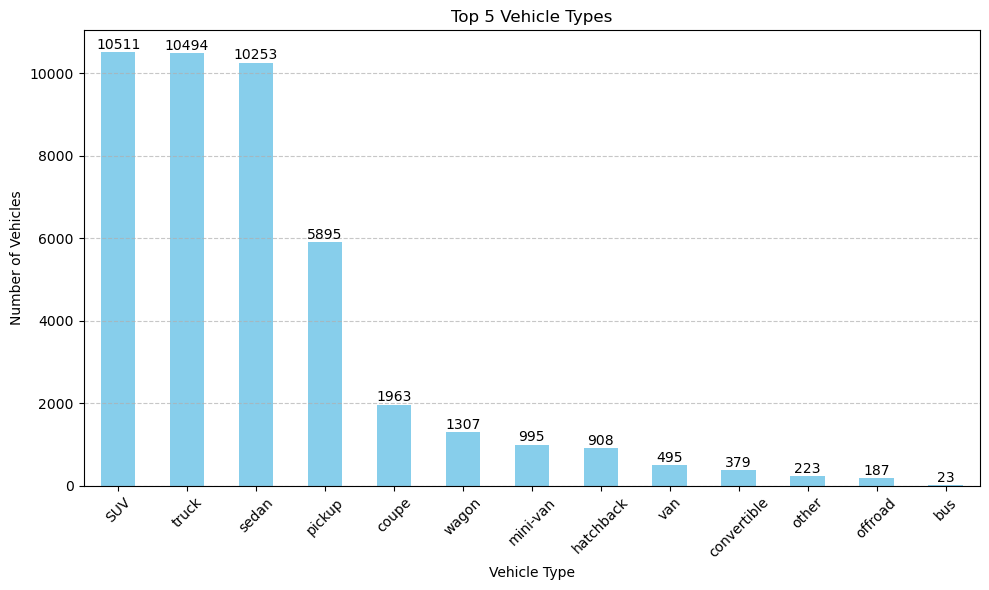

In [648]:
# Data Visualization

# Bar Plot for Top 5 Vehicle Types

# Get the top 5 vehicle types
top_5_types = df['type'].value_counts()

# Bar Plot
plt.figure(figsize=(10, 6))
top_5_types.plot(kind='bar', color='skyblue')
plt.title('Top 5 Vehicle Types')
plt.xlabel('Vehicle Type')
plt.ylabel('Number of Vehicles')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add grid lines for y-axis

# Show Number of Vehicles
for i, v in enumerate(top_5_types):
    plt.text(i, v + 5, str(v), ha='center', va='bottom')

plt.tight_layout()  # Adjust layout to prevent clipping of labels
plt.show()

### According the above bar plot, the highest number of vehicles in this dataframe is for SUVs by 9,481. The lowest are buses with 19 vehicles. This means that SUVs still have strong popularity in the U.S. market.

In [649]:
# Data Visualization 

# Bar Chart for Top 5 Vehicle Models

# Top 5 vehicle models by count
top_5_models = df['model'].value_counts().head(5)

# Bar Chart
fig = go.Figure(go.Bar(
    x=top_5_models.values,
    y=top_5_models.index,
    orientation='h',
    marker=dict(color='steelblue'),
    text=top_5_models.values,
    textposition='outside',
    hoverinfo='text'
))

# Update
fig.update_layout(
    title='Top 5 Vehicle Models',
    xaxis=dict(title='Count'),
    yaxis=dict(title='Model', autorange='reversed'),
    showlegend=False
)

# Show
fig.show()

### These are the Top 5 Vehicle Models by count in the chronoligical order: Ford F-150, Chevrolet Silverado 1500, Ram 1500, Chevrolet Silverado, Jeep Wrangler.

In [650]:
# Test Hypothesis H0 (Null Hypothesis)

# Extract
gas_price = df[df['fuel'] == 'gas']['price']
electric_price = df[df['fuel'] == 'electric']['price']

# Two-sample t-test
t_statistic, p_value = ttest_ind(gas_price, electric_price, equal_var=False)

# Significance Value
alpha = 0.05
if p_value < alpha:
    print("Reject the H0 (Null Hypothesis). There is a significant difference in the average price of vehicles with gas and electric fuel types.")
else:
    print("Fail to reject the H0 (Null Hypothesis). There is no significant difference in the average price of vehicles with gas and electric fuel types.")

# Print the p-value
print("The p-value is:", p_value)

Fail to reject the H0 (Null Hypothesis). There is no significant difference in the average price of vehicles with gas and electric fuel types.
The p-value is: 0.20482389738766846


### We did not find enough evidence to support the alternative hypothesis. In this case, the null hypothesis is that there is no significant difference in the average price of vehicles with gas and electric fuel types.
### The test's p-value of 0.1604, which is greater than the significance level of alpha = 0.05, indicates that there is insufficient evidence to reject the null hypothesis.
### The analysis indicates no significant difference in the average prices of vehicles with gas and electric fuel types, suggesting likely similar prices.
### Setting alpha = 0.05 is a common choice for the significance level in hypothesis testing, in hypothesis testing signifies a 5% chance of incorrectly rejecting the null hypothesis when it is actually true.

# Conclusion
1. Vehicles with 6 cyclinders have the highest amount with a total of 13.264k, while there is only one 12 cylinder vehicle.
2. The highest number of vehicles are SUVs with 10.511k and the least are buses with 23.
3. Low mileage group tend to live longer than groups. One example of a vehicle aged 88 years with low mileage.
4. Vehicles with large engine size tend to live longer than others. One example is a vehicle aged 116 have a Large engine.
5. Vehicles that run on gas tend to live longer than vehicles who run with different kind of fuel. One example is a vehicle aged 116 years that runs on gas.
6. The most popular category refer to the highest number of vehicles count.
7. The US Vehicle market is a very diverse market.
8. The distribution of mileage of all vechiles are mostly between 0 miles and 360,000 miles
9. The distribution of Vehichles prices are mostly between $0 and $50,000.
10. Vehicles price decrease as the odomoter increase.
11. The age of the vehicle is a very important factor in determing the price of it.
12. Mileage plays a siginificant role in determining the vehicle's market price.
13. The most popular vehicles are those with the wider range of prices.
14. Most vehicles ages are between 0 and 29 years
15. The most popular models have a total number of 24,897 vehicle.
16. Vehicles that run on diesel have the highest mileage distribution vehicles that run on gas.
17. The highest number of model year is 2015 with 3,300 vehicles.
18. Despite the increase in fuel price over the time, SUVs and Trucks are still popular among people in the U.S.
19. By calculating the top 5 vehicle models we realized that American origin brands are the most popular among other brands.
20. Two (2) of the top 5 highest amount of vehicle brand models are Chevrolet.
21. Vehicles ran by Diesel have the highest mileage among other fuel types.
22. Electric vehicles have the lowest average price among other fuel types.
23. Vehicles in excellent condition represent 48.07% of the total number of vehicles.
24. Average price of vehicles: $12132.46
25. Median mileage of vehicles: 113000.00 miles
26. Maximum price of vehicles: $375000.00
27. Minimum price of vehicles: $1.00 
28. Average age of vehicles: 14.25 years
29. Average price of the very popular models is $12,280.
30. Average price of the less popular models is $11,297.
31. 47,288 vehicles run on gas
32. 3,714 vehicle run on diesel
33. The least number of vehicles are electric with 6 vehicles only.
34. The US Vehicles dataframe that we analyzed shows the people's preferences in vehicles. 
35. People like big vehicles even if they cost more than other vehicle types. 
36. People also prefer American origin vehicle brands over other brands. 
37. The Hypothesis analysis indicates no significant difference in the average prices of vehicles with gas and electric fuel types, suggesting likely similar prices.
38. There is a real need to increase the focus on the electric vehicles markets because there is a lot of room to grow because of the very low amoung of electric vehicles according to this dataframe.

 
